📝 Project Title: COVID-19 Global Data Tracker

### Project Description:

In this project, learners will build a data analysis and reporting notebook (or app) that tracks global COVID-19 trends. The project will analyze cases, deaths, recoveries, and vaccinations across countries and time. Learners will clean and process real-world data, perform exploratory data analysis (EDA), generate insights, and visualize trends using Python data tools.

By the end, they’ll have a data analysis report with visuals and narrative insights, suitable for presentation or publishing.

### Data Collection

In [2]:
import pandas as pd

df = pd.read_csv("compact.csv")

df.head()

,country,date,total_cases,new_cases,new_cases_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths,new_deaths,...,population,population_density,median_age,life_expectancy,gdp_per_capita,extreme_poverty,diabetes_prevalence,handwashing_facilities,hospital_beds_per_thousand,human_development_index
0,Afghanistan,2020-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,40578801.0,62.215477,16.752,NaN,1516.2733,NaN,10.9,48.214695,0.39,0.462
1,Afghanistan,2020-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,40578801.0,62.215477,16.752,NaN,1516.2733,NaN,10.9,48.214695,0.39,0.462
2,Afghanistan,2020-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,40578801.0,62.215477,16.752,NaN,1516.2733,NaN,10.9,48.214695,0.39,0.462
3,Afghanistan,2020-01-04,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,...,40578801.0,62.215477,16.752,NaN,1516.2733,NaN,10.9,48.214695,0.39,0.462
4,Afghanistan,2020-01-05,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,...,40578801.0,62.215477,16.752,NaN,1516.2733,NaN,10.9,48.214695,0.39,0.462


### Data Loading & Exploration

In [3]:
df.info()

missing_values = df.isnull().sum()
print(missing_values)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 496820 entries, 0 to 496819
Data columns (total 61 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   country                                     496820 non-null  object 
 1   date                                        496820 non-null  object 
 2   total_cases                                 481566 non-null  float64
 3   new_cases                                   478834 non-null  float64
 4   new_cases_smoothed                          477619 non-null  float64
 5   total_cases_per_million                     481566 non-null  float64
 6   new_cases_per_million                       478834 non-null  float64
 7   new_cases_smoothed_per_million              477619 non-null  float64
 8   total_deaths                                481566 non-null  float64
 9   new_deaths                                  479575 non-null  float64
 

### Data Cleaning

In [4]:
clean_df = df.fillna(0)

### Exploratory Data Analysis (EDA)

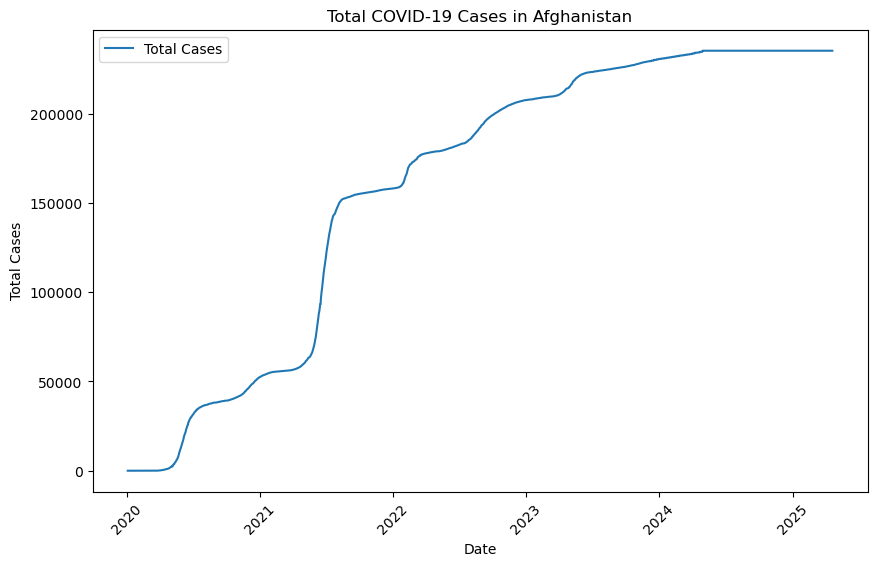

In [5]:
import matplotlib.pyplot as plt

# Convert 'date' column to datetime format
df['date'] = pd.to_datetime(df['date'])

# Example: Plot the total cases over time for a specific country
country_data = df[df['country'] == 'Afghanistan']
plt.figure(figsize=(10, 6))
plt.plot(country_data['date'], country_data['total_cases'], label='Total Cases')
plt.title('Total COVID-19 Cases in Afghanistan')
plt.xlabel('Date')
plt.ylabel('Total Cases')
plt.xticks(rotation=45)
plt.legend()
plt.show()

### Visualizing Vaccination Progress

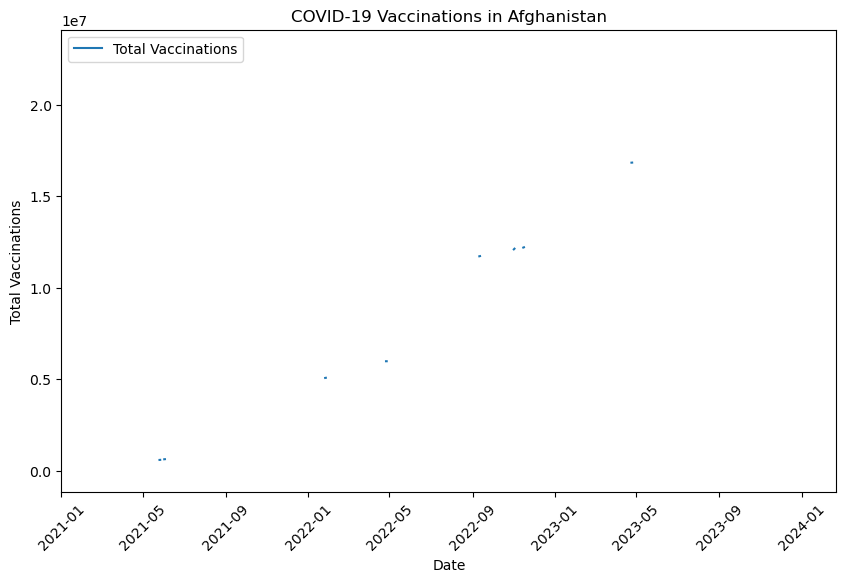

In [6]:
# Example: Plot total vaccinations for a specific country
plt.figure(figsize=(10, 6))
plt.plot(country_data['date'], country_data['total_vaccinations'], label='Total Vaccinations')
plt.title('COVID-19 Vaccinations in Afghanistan')
plt.xlabel('Date')
plt.ylabel('Total Vaccinations')
plt.xticks(rotation=45)
plt.legend()
plt.show()


### Build a Choropleth Map

In [7]:
import geopandas as gpd
import plotly.express as px

# Load a shapefile of countries
world = gpd.read_file("./ne_110m_admin_0_countries/ne_110m_admin_0_countries.shp")

# First, let's check what columns we have in the world dataframe
print(world.columns)

# Let's also check a few sample rows to understand the structure
print(world.head(2))

# Now let's do the correct merge
merged = pd.merge(
    world,
    df,
    left_on='NAME',  # This should be the column containing country names like 'Afghanistan'
    right_on='country',
    how='left'
)

# Plotting with ISO codes
fig = px.choropleth(
    merged,
    locations='ISO_A3',  # Use ISO country codes here
    color='total_cases',
    hover_name='NAME',
    color_continuous_scale='Viridis',
    title='COVID-19 Total Cases by Country'
)

fig.show()

Index(['featurecla', 'scalerank', 'LABELRANK', 'SOVEREIGNT', 'SOV_A3',
       'ADM0_DIF', 'LEVEL', 'TYPE', 'TLC', 'ADMIN',
       ...
       'FCLASS_TR', 'FCLASS_ID', 'FCLASS_PL', 'FCLASS_GR', 'FCLASS_IT',
       'FCLASS_NL', 'FCLASS_SE', 'FCLASS_BD', 'FCLASS_UA', 'geometry'],
      dtype='object', length=169)
        featurecla  scalerank  LABELRANK                   SOVEREIGNT SOV_A3  \
0  Admin-0 country          1          6                         Fiji    FJI   
1  Admin-0 country          1          3  United Republic of Tanzania    TZA   

   ADM0_DIF  LEVEL               TYPE TLC                        ADMIN  ...  \
0         0      2  Sovereign country   1                         Fiji  ...   
1         0      2  Sovereign country   1  United Republic of Tanzania  ...   

  FCLASS_TR  FCLASS_ID FCLASS_PL FCLASS_GR  FCLASS_IT FCLASS_NL FCLASS_SE  \
0      None       None      None      None       None      None      None   
1      None       None      None      None       None  

### Insights & Reporting

In [9]:
import pandas as pd
from IPython.display import display

# Calculate the correlation between cases and vaccinations
correlation = df[['total_cases', 'total_vaccinations']].corr()

# Format the correlation matrix as a table
correlation_table = correlation.round(3)  # Round for neatness

# Display the correlation table
print("Correlation between total cases and total vaccinations")
display(correlation_table)

# Find the country with the highest number of total cases
country_max_cases = df.groupby('country')['total_cases'].max().idxmax()
max_cases_value = df.groupby('country')['total_cases'].max().max()

# Format and display the country with highest cases
summary_table = pd.DataFrame({
    'Country with Highest Cases': [country_max_cases],
    'Total Cases': [max_cases_value]
})

print("Summary Insight")
display(summary_table)



Correlation between total cases and total vaccinations


,total_cases,total_vaccinations
total_cases,1.000,0.865
total_vaccinations,0.865,1.000


Summary Insight


,Country with Highest Cases,Total Cases
0,World,777637669.0
